# CNN model training

In [2]:
from matplotlib import pyplot as plt
from PIL import Image
import csv
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as fun
from torch.utils.data import Dataset, DataLoader
import torch.optim as optim
import pandas as pd
import os
import cv2
import gc
from torchsummary import summary
import torchvision.transforms as transforms

In [3]:
#probaj napravit da ti piše:
#= Using device cuda
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"= Using device {device}")
torch.cuda.is_available()

= Using device cuda


True

### 1. DATASET


DATASET from WIDER FACE: A Face Detection Benchmark

link: https://shuoyang1213.me/WIDERFACE/

    1. download WIDER Face Training Images (used for training)
    2. download WIDER Face Validation Images (used for testing since WIDER face test images are not annotated)
    3. download Face Annotations
            -- from this file extract wider_face_train_bbx_gt.txt and wider_face_val_bbx_gt.txt (these txt files contain bounding box of face for each image(left, top, width, height))
    

main directory should look like this:

<img src="directory.png"
     alt="cirectories"
     style="float: left; margin-right: 10px;" />

#### Data for bounding box

In [4]:
# function to create annotation for each image (path of image + bounding box of face)

def create_annotations(path, pres):
    images_info = []
    
    with open(path) as f:
        lines = f.readlines()

    i = 0
    while i < len(lines):
        tmp = lines[i+1]

        if int(tmp)==1: #one person per image
            image_info = []

            image_path = pres + lines[i]    #image name
            bounds = lines[i+2].split(" ")
            x = int(bounds[0])  # x to left
            y = int(bounds[1])  # top
            width = int(bounds[2]) # width of face
            height = int(bounds[3]) # height of face

            image_info.extend([image_path.strip(), x, y, width, height])
            images_info.append(image_info)

            i = i + 3
        else:
            if int(tmp) == 0:
                i = i + 3
            else :   
                i = i + int(tmp) + 2
        
    return images_info

In [5]:
#train dataset annotation
path = "wider_face_train_bbx_gt.txt"
images_info_train = create_annotations(path, "WIDER_train/images/")

In [6]:
#test dataset annotation
path = "wider_face_val_bbx_gt.txt"
images_info_test = create_annotations(path, "WIDER_val/images/")

In [7]:
for i in range(1,12):
    images_info_train.pop(-i)

In [8]:
#number of images in train set
len(images_info_train)

4620

In [9]:
for i in range(1,3):
    images_info_test.pop(-i)

In [10]:
#number of images in test set
len(images_info_test)

1120

EXAMPLE IMAGE IN DATASET
IMAGE INFO: NAME, x, y, width, height : 
['WIDER_val/images/9--Press_Conference/9_Press_Conference_Press_Conference_9_658.jpg', 247, 178, 364, 491]


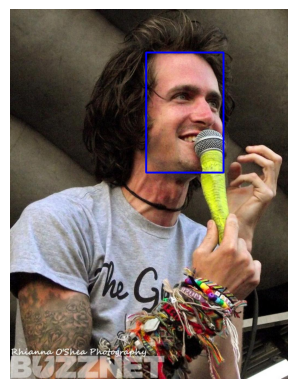

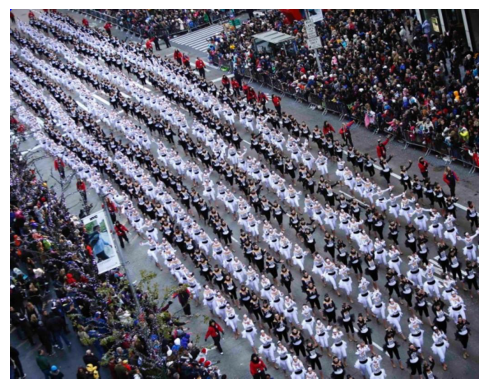

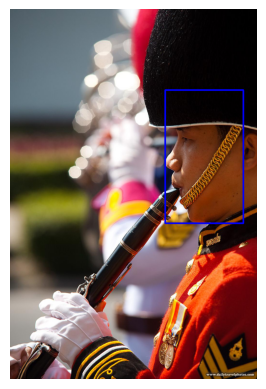

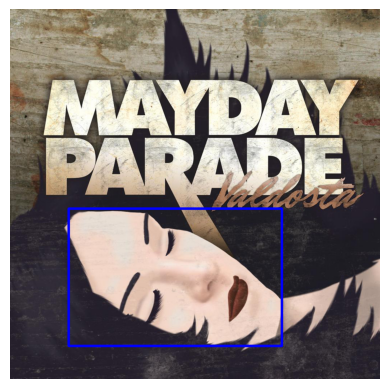

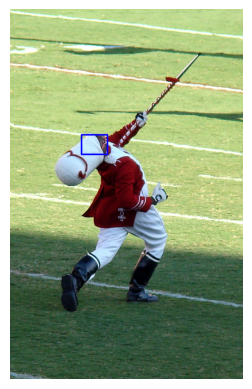

...

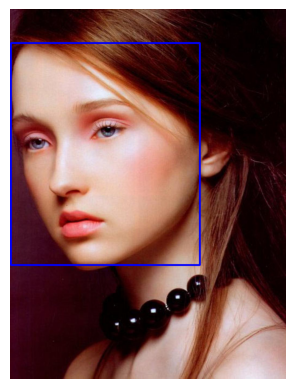

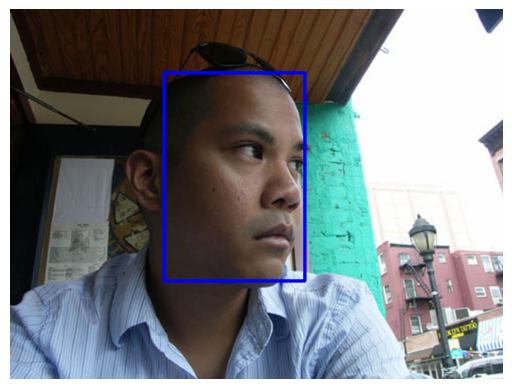

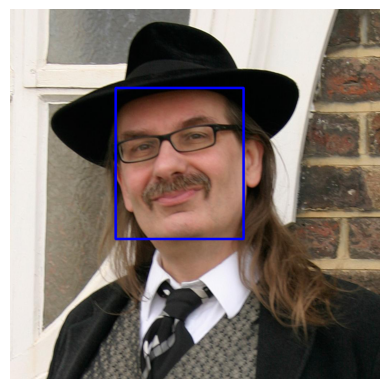

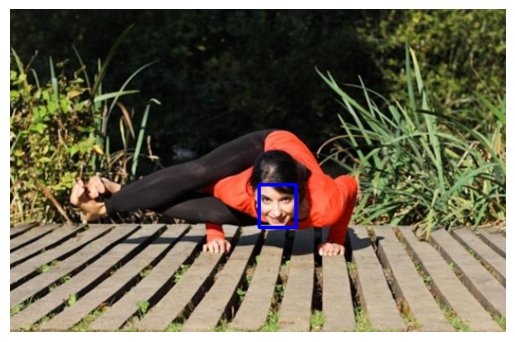

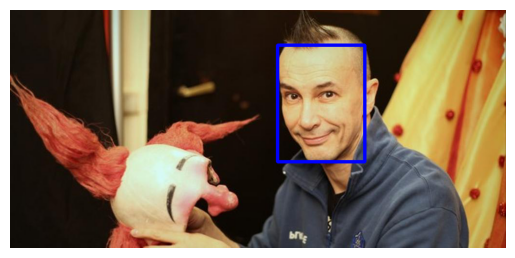

In [11]:
#example image from dataset
#display of image and bounding box around the face
print("EXAMPLE IMAGE IN DATASET")
print("IMAGE INFO: NAME, x, y, width, height : ")
pp = -16
print(images_info_test[pp])


for i in range(100):
    path = images_info_test[i][0]
    img = cv2.imread(path)

    x = int(images_info_test[i][1])
    y = int(images_info_test[i][2])
    width = int(images_info_test[i][3])
    height = int(images_info_test[i][4])
    image = cv2.rectangle(img, (x, y),(x+width, y+height) , (255, 0, 0), 5)

    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


NORMALISED EXAMPLE IMAGE IN DATASET
IMAGE INFO: NAME, x, y, width, height : 
['WIDER_val/images/9--Press_Conference/9_Press_Conference_Press_Conference_9_658.jpg', 247, 178, 364, 491]

mean and std before normalize:
Mean of the image: tensor([0.4340, 0.4178, 0.4367])
Std of the image: tensor([0.2667, 0.2590, 0.2764])


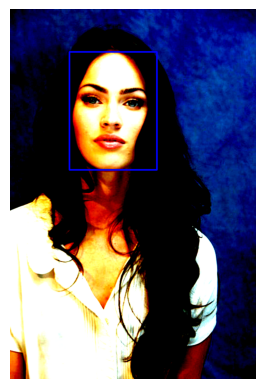

Mean and Std of normalized image:
Mean of the image: tensor([ 1.2908e-07, -1.0079e-07,  9.4051e-09])
Std of the image: tensor([1.0000, 1.0000, 1.0000])


In [12]:
print("NORMALISED EXAMPLE IMAGE IN DATASET")
print("IMAGE INFO: NAME, x, y, width, height : ")
pp = -16
print(images_info_test[pp])

path = images_info_test[pp][0]
img = cv2.imread(path)

transform = transforms.Compose([
    transforms.ToTensor()
])
img_tr = transform(img)
mean, std = img_tr.mean([1,2]), img_tr.std([1,2])

# print mean and std
print()
print("mean and std before normalize:")
print("Mean of the image:", mean)
print("Std of the image:", std)

transform_norm = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

img_normalized = transform_norm(img)
 
# convert this image to numpy array
img_normalized = np.array(img_normalized)
 
# transpose from shape of (3,,) to shape of (,,3)
img_normalized = img_normalized.transpose(1, 2, 0).copy() 


x = int(images_info_test[pp][1])
y = int(images_info_test[pp][2])
width = int(images_info_test[pp][3])
height = int(images_info_test[pp][4])
image = cv2.rectangle(img_normalized, (x, y),(x+width, y+height) , (255, 0, 0), 5)
    
# display the normalized image
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()


# get normalized image
img_nor = transform_norm(img)
 
# cailculate mean and std
mean, std = img_nor.mean([1,2]), img_nor.std([1,2])
 
# print mean and std
print("Mean and Std of normalized image:")
print("Mean of the image:", mean)
print("Std of the image:", std)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


FLIPPED EXAMPLE IMAGE IN DATASET
IMAGE INFO: NAME, x, y, width, height : 
['WIDER_val/images/9--Press_Conference/9_Press_Conference_Press_Conference_9_658.jpg', 247, 178, 364, 491]


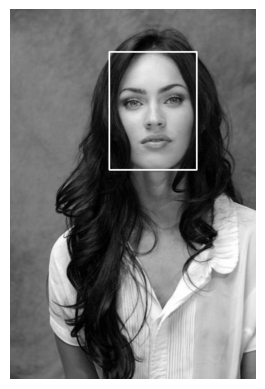

In [13]:
print("FLIPPED EXAMPLE IMAGE IN DATASET")
print("IMAGE INFO: NAME, x, y, width, height : ")
pp = -16
print(images_info_test[pp])

path = images_info_test[pp][0]
img = cv2.imread(path)

transform_inverted = transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(1),
    transforms.Grayscale()
])

img_flipped = transform_inverted(img)
 
# convert this image to numpy array
img_flipped = np.array(img_flipped)
 
# transpose from shape of (3,,) to shape of (,,3)
img_flipped = img_flipped.transpose(1, 2, 0).copy()

width = int(images_info_test[pp][3])
height = int(images_info_test[pp][4])
x = int(img_flipped.shape[1] - images_info_test[pp][1] - width)
y = int(images_info_test[pp][2])
image = cv2.rectangle(img_flipped, (x, y),(x+width, y+height) , (255, 0, 0), 5)
    
# display the normalized image
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.axis('off')
plt.show()

#### Images data

In [14]:
train_size = len(images_info_train)
test_size = len(images_info_test)
resize_size = 256


###### Train images dataset

In [15]:
#directory for test dataset
try:
    os.makedirs("train_dataset")
except FileExistsError:
    # directory already exists
    pass

In [16]:
#transformacije podataka, tu možeš dodat svašta, ali možda je bolje ništa?!

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Grayscale()
    #transforms.ColorJitter(brightness=0.2, saturation=0.2, hue=0.2)
])

transform_inverted = transforms.Compose([
    transforms.ToTensor(),
    transforms.RandomHorizontalFlip(1),
    transforms.Grayscale()
    #transforms.ColorJitter(brightness=0.2, saturation=0.2, hue=0.2)
])

In [17]:
from torchvision.utils import save_image

#creating image train dataset
channels_sum, channels_squared_sum, num_batches = 0, 0, 0

for i in range(0,train_size):

    image_info = images_info_train[i]
    image_path = image_info[0]
    
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    x = int(image_info[1])
    y = int(image_info[2])
    width = int(image_info[3])
    height = int(image_info[4])
    
    #rescaling images to 224x224 pixels, variable resize_size = 224
    original_height = img.shape[0]
    original_width = img.shape[1]
    
    images_info_train[i][1] = float(x/(original_width/resize_size))
    images_info_train[i][2] = float(y/(original_height/resize_size))
    images_info_train[i][3] = float(width/(original_width/resize_size))
    images_info_train[i][4] = float(height/(original_height/resize_size))
    
    img = cv2.resize(img, (resize_size, resize_size))
    
    img_tr = transform(img)
    
    channels_sum += torch.mean(img_tr, dim=[1,2])
    channels_squared_sum += torch.mean(img_tr**2, dim=[1,2])
    num_batches += 1
    
    #img_tr = np.array(img_tr)
    #img_tr = img_tr.transpose(1, 2, 0).copy()
    
    #save image to folder train_dataset
    #cv2.imwrite("train_dataset"+'\\'+image_path.split("/")[3], img)
    save_image(img_tr, "train_dataset"+'\\'+image_path.split("/")[3])
    
    #ovaj kod ispod je za poduplat training data tako da za svaki postojeci invertas sliku i rjesenje
    #zakomentiraj ako ne zelis koristit
    #######################
    img_flipped = transform_inverted(img)
    
    width = int(images_info_train[i][3])
    height = int(images_info_train[i][4])
    x = int(img_flipped.shape[1] - images_info_train[i][1] - width)
    y = int(images_info_train[i][2])
    images_info_train.append([images_info_train[i][0], x, y, width, height])
    
    channels_sum += torch.mean(img_flipped, dim=[1,2])
    channels_squared_sum += torch.mean(img_flipped**2, dim=[1,2])
    num_batches += 1
 
    #img_flipped = np.array(img_flipped)
    #img_flipped = img_flipped.transpose(1, 2, 0).copy()
    
    #save image to folder train_dataset
    #cv2.imwrite("train_dataset"+'\\inv_'+image_path.split("/")[3], img_flipped)
    save_image(img_flipped, "train_dataset"+'\\inv_'+image_path.split("/")[3])
    
    #########################

#mean i std ti kasnije trebaju za normalizaciju svih podataka 
mean = channels_sum / num_batches
std = (channels_squared_sum / num_batches - mean ** 2) ** 0.5
train_size = len(images_info_train)
print(mean, std)

tensor([0.4611]) tensor([0.2895])


In [18]:
f = open('cvs_train.cvs', 'w')

writer = csv.writer(f)

i = 0

while i < len(images_info_train):
    row = [images_info_train[i][1], images_info_train[i][2], images_info_train[i][3], images_info_train[i][4]]
    writer.writerow(row)
    i = i + 1

f.close()


##### Test images dataset

In [19]:
#directory for test dataset
try:
    os.makedirs("test_dataset")
except FileExistsError:
    # directory already exists
    pass

In [20]:
#creating image test dataset

for i in range(0,test_size):

    image_info = images_info_test[i]
    image_path = image_info[0]
    
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    
    x = int(image_info[1])
    y = int(image_info[2])
    width = int(image_info[3])
    height = int(image_info[4])
    

    #rescaling images to 224x224 pixels, variable resize_size = 224
    original_height = img.shape[0]
    original_width = img.shape[1]
    
    
    images_info_test[i][1] = float(x/(original_width/resize_size))
    images_info_test[i][2] = float(y/(original_height/resize_size))
    images_info_test[i][3] = float(width/(original_width/resize_size))
    images_info_test[i][4] = float(height/(original_height/resize_size))
    
    #cv2.rectangle(img, (x, y), (x + width, y + height), (255, 0, 0), 5)

    img = cv2.resize(img, (resize_size, resize_size)) 
    img_norm = transform(img)
    
    
    #save image to folder test_dataset
    #cv2.imwrite("test_dataset"+'\\'+image_path.split("/")[3], img_norm)
    save_image(img_norm, "test_dataset"+'\\'+image_path.split("/")[3])
    

In [21]:
f = open('cvs_test.cvs', 'w')

writer = csv.writer(f)

i = 0

while i < len(images_info_test):
    row = [images_info_test[i][1], images_info_test[i][2], images_info_test[i][3], images_info_test[i][4]]
    writer.writerow(row)
    i = i + 1

f.close()

### MODELS (runnaj samo jednog)

In [ ]:
"""
#starting
class cnn_model(nn.Module):

    def __init__(self):
        
        super(cnn_model, self).__init__()

        self.conv1 = nn.Conv2d(
            in_channels=3,
            out_channels=32,
            kernel_size=5,
            stride=2,
            padding=0
        )

        self.conv2 = nn.Conv2d(
            in_channels=32,
            out_channels=64,
            kernel_size=5,
            stride=1,
            padding=0
        )

        self.conv3 = nn.Conv2d(
            in_channels=64,
            out_channels=128,
            kernel_size=5,
            stride=1,
            padding=0
        )


        self.fc1 = nn.Linear(
            in_features=25*25*128,
            out_features=2046
        )

        self.fc2 = nn.Linear(
            in_features=2046,
            out_features=4
        )

    def forward(self, val):
        val = fun.relu(self.conv1(val))
        val = fun.max_pool2d(val, kernel_size=2, stride=2)
        val = fun.relu(self.conv2(val))
        val = fun.max_pool2d(val, kernel_size=2, stride=2)
        val = fun.relu(self.conv3(val))
        val = val.view(-1, 25*25*128)
        val = fun.dropout(fun.relu(self.fc1(val)), p=0.5, training=self.training)
        val = self.fc2(val)

        return val
"""

In [ ]:
#mlohave sise
"""
class cnn_model(nn.Module):

    def __init__(self):
        
        super(cnn_model, self).__init__()

        self.conv1 = nn.Conv2d(
            in_channels=3,
            out_channels=32,
            kernel_size=3,
            stride=1,
            padding=0
        )
        
        self.conv2 = nn.Conv2d(
            in_channels=32,
            out_channels=32,
            kernel_size=3,
            stride=1,
            padding=0
        )
        
        self.conv3 = nn.Conv2d(
            in_channels=32,
            out_channels=64,
            kernel_size=3,
            stride=1,
            padding=0
        )
        
        self.conv4 = nn.Conv2d(
            in_channels=64,
            out_channels=128,
            kernel_size=3,
            stride=1,
            padding=0
        )

        self.conv5 = nn.Conv2d(
            in_channels=128,
            out_channels=128,
            kernel_size=3,
            stride=1,
            padding=0
        )
        
        self.conv6 = nn.Conv2d(
            in_channels=128,
            out_channels=256,
            kernel_size=3,
            stride=1,
            padding=0
        )

        self.fc1 = nn.Linear(
            in_features = 43264,
            out_features=2046
        )

        self.fc2 = nn.Linear(
            in_features=2046,
            out_features=4
        )

    def forward(self, val):
        val = fun.relu(self.conv1(val))
        val = fun.relu(self.conv2(val))
        val = fun.relu(self.conv3(val))
        val = fun.max_pool2d(val, kernel_size=2, stride=2)
        val = fun.dropout(val, p=0.5, training=self.training)
        
        val = fun.relu(self.conv4(val))
        val = fun.max_pool2d(val, kernel_size=2, stride=2)
        val = fun.dropout(val, p=0.5, training=self.training)
        
        val = fun.relu(self.conv5(val))
        val = fun.max_pool2d(val, kernel_size=2, stride=2)
        val = fun.dropout(val, p=0.5, training=self.training)
       
        val = fun.relu(self.conv6(val))
        val = fun.max_pool2d(val, kernel_size=2, stride=2)
        val = fun.dropout(val, p=0.5, training=self.training)

        val = torch.flatten(val, 1)
        val = fun.dropout(fun.relu(self.fc1(val)), p=0.5, training=self.training)
        val = self.fc2(val)

        return val
"""

In [ ]:
#AlexNet
"""
class cnn_model(nn.Module):

    def __init__(self):
        
        super(cnn_model, self).__init__()

        self.conv1 = nn.Conv2d(
            in_channels=3,
            out_channels=96,
            kernel_size=11,
            stride=4,
            padding=0
        )

        self.conv2 = nn.Conv2d(
            in_channels=96,
            out_channels=256,
            kernel_size=5,
            stride=1,
            padding=2
        )

        self.conv3 = nn.Conv2d(
            in_channels=256,
            out_channels=384,
            kernel_size=3,
            stride=1,
            padding=1
        )
        
        self.conv4 = nn.Conv2d(
            in_channels=384,
            out_channels=384,
            kernel_size=3,
            stride=1,
            padding=1
        )
        
        self.conv5 = nn.Conv2d(
            in_channels=384,
            out_channels=256,
            kernel_size=3,
            stride=1,
            padding=1
        )

        self.fc1 = nn.Linear(
            in_features=6*6*256,
            out_features=4096
        )
        
        self.fc2 = nn.Linear(
            in_features=4096,
            out_features=1024
        )

        self.fc3 = nn.Linear(
            in_features=1024,
            out_features=4
        )

    def forward(self, val):
        val = fun.relu(self.conv1(val))
        val = fun.max_pool2d(val, kernel_size=3, stride=2)
        val = fun.relu(self.conv2(val))
        val = fun.max_pool2d(val, kernel_size=3, stride=2)
        val = fun.relu(self.conv3(val))
        val = fun.relu(self.conv4(val))
        val = fun.relu(self.conv5(val))
        val = fun.max_pool2d(val, kernel_size=3, stride=2)
        val = val.view(-1, 6*6*256)
        val = fun.dropout(fun.relu(self.fc1(val)), p=0.5, training=self.training)
        val = fun.dropout(fun.relu(self.fc2(val)), p=0.5, training=self.training)
        val = self.fc3(val)

        return val
"""

In [22]:
class conv_block(nn.Module):
    
    def __init__(self, in_channels, out_channels, **kwargs):
        
        super(conv_block, self).__init__()
        
        self.conv = nn.Conv2d(in_channels, out_channels, **kwargs)
        self.batchnorm = nn.BatchNorm2d(out_channels)
        
    def forward(self, val):
        return fun.relu(self.batchnorm(self.conv(val)))
        

class Inception_block(nn.Module):
    
    def __init__(self, in_channels, out1x1, red3x3, out3x3, red5x5, out5x5, out1x1pool):
        
        super(Inception_block, self).__init__()
        
        self.branch1 = conv_block(in_channels, out1x1, kernel_size=1)
        
        self.branch2 = nn.Sequential(
            conv_block(in_channels, red3x3, kernel_size=1),
            conv_block(red3x3, out3x3, kernel_size=3, padding=1)
        )
        
        self.branch3 = nn.Sequential(
            conv_block(in_channels, red5x5, kernel_size=1),
            conv_block(red5x5, out5x5, kernel_size=5, padding=2)
        )
        
        self.branch4 = nn.Sequential(
            nn.MaxPool2d(kernel_size=3, stride=1, padding=1),
            conv_block(in_channels, out1x1pool, kernel_size=1)
        )
        
        
    def forward(self, val):
        return torch.cat([self.branch1(val), self.branch2(val), self.branch3(val), self.branch4(val)], 1)

        
#GoogLeNet
class cnn_model(nn.Module):

    def __init__(self):
        
        super(cnn_model, self).__init__()

        self.conv1 = conv_block(
            in_channels=1,
            out_channels=64,
            kernel_size=7,
            stride=2,
            padding=3
        )

        self.conv2 = conv_block(
            in_channels=64,
            out_channels=192,
            kernel_size=3,
            stride=1,
            padding=1
        )

        self.inception3a = Inception_block(192, 64, 96, 128, 16, 32, 32)
        self.inception3b = Inception_block(256, 128, 128, 192, 32, 96, 64)
        
        self.inception4a = Inception_block(480, 192, 96, 208, 16, 48, 64)
        self.inception4b = Inception_block(512, 160, 112, 224, 24, 64, 64)
        self.inception4c = Inception_block(512, 128, 128, 256, 24, 64, 64)
        self.inception4d = Inception_block(512, 112, 144, 288, 32, 64, 64)
        self.inception4e = Inception_block(528, 256, 160, 320, 32, 128, 128)
        
        self.inception5a = Inception_block(832, 256, 160, 320, 32, 128, 128)
        self.inception5b = Inception_block(832, 384, 192, 384, 48, 128, 128)
        
        self.fc1 = nn.Linear(
            in_features=1024,
            out_features=4
        )
        

    def forward(self, val):
        val = fun.relu(self.conv1(val))
        val = fun.max_pool2d(val, kernel_size=3, stride=2)
        val = fun.relu(self.conv2(val))
        val = fun.max_pool2d(val, kernel_size=3, stride=2)
        
        val = self.inception3a(val)
        val = self.inception3b(val)
        val = fun.max_pool2d(val, kernel_size=3, stride=2)
        
        val = self.inception4a(val)
        val = self.inception4b(val)
        val = self.inception4c(val)
        val = self.inception4d(val)
        val = self.inception4e(val)
        val = fun.max_pool2d(val, kernel_size=3, stride=2)

        val = self.inception5a(val)
        val = self.inception5b(val)
        val = fun.avg_pool2d(val, kernel_size=7, stride=1)
        
        val = val.reshape(val.shape[0], -1)
        val = fun.dropout(val, p=0.4, training=self.training)
        val = self.fc1(val)
        
        return val

In [23]:
#najbolji model je ovaj odmah iznad
model = cnn_model().to(device)

In [24]:
#summary(model1, (3, 224, 224)) #starting
#summary(model2, (3, 224, 224)) #mlohave sise
#summary(model3, (3, 224, 224)) #AlexNet
summary(model, (1, 256, 256)) #GoogLeNet


print(images_info_train[0])
img = cv2.imread(images_info_train[0][0], cv2.IMREAD_GRAYSCALE)

print(img.shape)

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           3,200
       BatchNorm2d-2         [-1, 64, 128, 128]             128
        conv_block-3         [-1, 64, 128, 128]               0
            Conv2d-4          [-1, 192, 63, 63]         110,784
       BatchNorm2d-5          [-1, 192, 63, 63]             384
        conv_block-6          [-1, 192, 63, 63]               0
            Conv2d-7           [-1, 64, 31, 31]          12,352
       BatchNorm2d-8           [-1, 64, 31, 31]             128
        conv_block-9           [-1, 64, 31, 31]               0
           Conv2d-10           [-1, 96, 31, 31]          18,528
      BatchNorm2d-11           [-1, 96, 31, 31]             192
       conv_block-12           [-1, 96, 31, 31]               0
           Conv2d-13          [-1, 128, 31, 31]         110,720
      BatchNorm2d-14          [-1, 128,

In [25]:
#normalizacija
transform_norm = transforms.Compose([
    transforms.ToTensor(),
    #transforms.Normalize(mean, std)
])

In [ ]:
#dont run
"""
i = 0

test_images_l = []

while i < len(images_info_test):
    img = cv2.imread("./test_dataset/"+images_info_test[i][0].split("/")[3], cv2.IMREAD_COLOR)
    img_normalized = transform_norm(img)
    arr = np.array(img_normalized)
    arr = arr.transpose(1, 2, 0).copy() 
    arr = arr.ravel()
    test_images_l.append(arr.tolist())
    i = i + 1
"""

In [ ]:
#dont run
#len(test_images_l)

In [ ]:
"""
#dont run
i = 0

train_images_l = []

while i < train_size: #/2
    img = cv2.imread("./train_dataset/"+images_info_train[i][0].split("/")[3], cv2.IMREAD_COLOR)
    img_normalized = transform_norm(img)
    arr = np.array(img_normalized)
    arr = arr.transpose(1, 2, 0).copy()
    arr = arr.ravel()
    train_images_l.append(arr.tolist())
    i = i + 1
"""

In [ ]:
#dont run
#len(train_images_l)

In [27]:
def evaluate(net, test_loader, criterion, size, device, err=10): #err koliko smije grijesiti a da bude klasificiran kao true
    net.eval()
    
    test_loss = 0
    acc = 0
    id = torch.tensor([True, True, True, True], device=device)
    
    #rands = np.random.randint(test_size, size=size)
    for i, data in enumerate(test_loader):
        inputs, _ = data
        inputs = inputs.view(1, 1, 256, 256).to(device)

        outputs = torch.squeeze(net(inputs))
        labels = torch.Tensor(np.array(images_info_test[i][1:])).to(device)

        temp_loss = criterion(outputs, labels)
        
        correct = (temp_loss<=err).eq(id).sum().item()/4
        
        acc = acc + correct
        #test_loss = test_loss + temp_loss
        
        del inputs, outputs, labels
     
    return acc*100/size
    #return test_loss/size

In [28]:
def train_model(net, train_loader, test_loader, batchSize, epochs, lr_rate, momentum, device):
    prev_loss=0
    criterion = nn.MSELoss()
    criterion2 = nn.L1Loss(size_average=False, reduce=False, reduction='none')
    optimization = optim.SGD(net.parameters(), lr=lr_rate, momentum=momentum)
    scheduler = optim.lr_scheduler.StepLR(optimization, step_size=30, gamma=0.1)

    for epoch in range(epochs):
        net.train()
        
        loss_avg = 0
        
        for i, data in enumerate(train_loader):
            optimization.zero_grad()

            inputs, labels = data
            inputs, labels = inputs.view(batchSize, 1, 256, 256).to(device), labels.view(batchSize, 4).to(device)

            outputs = net(inputs)
            
            loss = criterion(outputs, labels)
            loss.backward()
            optimization.step()
            
            del inputs, outputs, labels
            
            loss_avg = loss_avg + loss.item()
        
        scheduler.step()
        train_loss=loss_avg/batchSize
        print("epoch " + str(epoch+1) + ".  loss: " + str(train_loss))
        
        #ako CUDA memorija zapne, smanji size
        test_loss = evaluate(net, test_loader, criterion2, test_size, device)
        
        print("     avg test acc for this epoch: " + str(test_loss) + "%")
        if abs(train_loss-prev_loss)<0.1:
            break
        prev_loss=train_loss
        
        if test_loss > 80:
            torch.save(model.state_dict(), './model-saved' + str(epoch+1) + '.pth')
            break


In [29]:
#ako ne zelis dupli data, napravi __getitem__ ko u testing
class training_dataset(Dataset):
    
    def __init__(self):
        #trainX = np.asarray(images)
        #trainX = np.asarray(pd.read_csv('train_images_l.cvs', sep=',', header=None))
        self.img_dir = "./train_dataset/"
        self.len = len(images_info_train)
        self.images=images_info_train
        
        trainY = np.asarray(pd.read_csv('cvs_train.cvs', sep=',', header=None))
        
        #self.features_train = torch.Tensor(trainX)
        self.groundTruth_train = torch.Tensor(trainY)

    def __getitem__(self, i):
        if i<self.len/2:
            img = cv2.imread(self.img_dir+self.images[i][0].split("/")[3], cv2.IMREAD_GRAYSCALE)
        else:
            img = cv2.imread(self.img_dir+"inv_"+self.images[i][0].split("/")[3], cv2.IMREAD_GRAYSCALE) 
        img_normalized = transform_norm(img)
        #arr = np.array(img_normalized)
        #arr = arr.transpose(1, 2, 0).copy() 
        #arr = arr.ravel()
        
        return img_normalized, self.groundTruth_train[i]

    def __len__(self):
        return self.len
    
ts = training_dataset()

In [30]:
class testing_dataset(Dataset):
    
    def __init__(self):
        #trainX = np.asarray(images)
        #trainX = np.asarray(pd.read_csv('train_images_l.cvs', sep=',', header=None))
        self.img_dir = "./test_dataset/"
        self.len = len(images_info_test)
        self.images=images_info_test
        
        trainY = np.asarray(pd.read_csv('cvs_test.cvs', sep=',', header=None))
        
        #self.features_train = torch.Tensor(trainX)
        self.groundTruth_train = torch.Tensor(trainY)

    def __getitem__(self, i):
        #if i<self.len/2:
        img = cv2.imread(self.img_dir+self.images[i][0].split("/")[3], cv2.IMREAD_GRAYSCALE)
        #else:
            #img = cv2.imread(self.img_dir+"inv_"+self.images[i][0].split("/")[3], cv2.IMREAD_COLOR) 
        img_normalized = transform_norm(img)
        #arr = np.array(img_normalized)
        #arr = arr.transpose(1, 2, 0).copy() 
        #arr = arr.ravel()
        
        return img_normalized, self.groundTruth_train[i]

    def __len__(self):
        return self.len

test_ds = testing_dataset()

In [31]:
learning_rate = 0.00001
momentum = 0.9
batch = 40
no_of_workers = 0
shuffle = True
epochs = 60

train_loader = DataLoader(
        dataset=ts,
        batch_size=batch,
        shuffle=shuffle,
        pin_memory=True,
        num_workers=no_of_workers)

test_loader = DataLoader(
        dataset=test_ds,
        batch_size=1,
        shuffle=False,
        pin_memory=True,
        num_workers=no_of_workers)

In [32]:
train_model(model, train_loader, test_loader, batch, epochs, learning_rate, momentum, device)

C:\Users\Dominik\anaconda3\envs\nnets\lib\site-packages\torch\nn\_reduction.py:42: UserWarning: size_average and reduce args will be deprecated, please use reduction='none' instead.
  warnings.warn(warning.format(ret))


epoch 1.  loss: 15439.274545288086
     avg test acc for this epoch: 25.602678571428573%
epoch 2.  loss: 6298.519584655762
     avg test acc for this epoch: 14.553571428571429%
epoch 3.  loss: 5247.327885437012
     avg test acc for this epoch: 28.973214285714285%
epoch 4.  loss: 4583.689614105225
     avg test acc for this epoch: 28.705357142857142%
epoch 5.  loss: 3946.7517501831053
     avg test acc for this epoch: 38.59375%
epoch 6.  loss: 3360.53137512207
     avg test acc for this epoch: 38.325892857142854%
epoch 7.  loss: 2891.0453620910644
     avg test acc for this epoch: 45.29017857142857%
epoch 8.  loss: 2352.189682006836
     avg test acc for this epoch: 36.830357142857146%
epoch 9.  loss: 2006.3532745361329
     avg test acc for this epoch: 52.388392857142854%
epoch 10.  loss: 1804.5969329833983
     avg test acc for this epoch: 58.191964285714285%
epoch 11.  loss: 1399.0105003356935
     avg test acc for this epoch: 59.151785714285715%
epoch 12.  loss: 1207.4732734680176


In [33]:
torch.cuda.memory_allocated()
print(len(images_info_train))

9240


In [34]:
#run after you want to save a model
torch.save(model.state_dict(), './model_google-gray-60-epoch-1-chn.pth')

In [35]:
#run after every training to clear access memory
gc.collect()
torch.cuda.empty_cache()

###### example test for images in test dataset

In [36]:
def test_image(index):
    
    img = cv2.imread("./test_dataset/"+images_info_test[index][0].split("/")[3], cv2.IMREAD_GRAYSCALE) 
    image_true = cv2.rectangle(img, (int(images_info_test[index][1]), int(images_info_test[index][2])),(int(images_info_test[index][3]) + 
                                                                               int(images_info_test[index][1]),
                                              int(images_info_test[index][4]) + int(images_info_test[index][2])) , (255, 0, 0), 1)
    #image_true = cv2.resize(image, (600, 800))
    
    inputs = transform_norm(img)
    #inputs = np.array(inputs).transpose(1, 2, 0).copy()
    #inputs = torch.Tensor(inputs.ravel())
    inputs = inputs.view(1, 1, 256, 256)
    predict = torch.squeeze(model(inputs.to(device)).detach().cpu()).tolist()
    
    print("true value of bounding box:")
    print(images_info_test[index][1:])
    print()
    print("predicted value of bounding box:")
    print(predict)
    
    img = cv2.imread("./test_dataset/"+images_info_test[index][0].split("/")[3], cv2.IMREAD_COLOR) 
    image_pred = cv2.rectangle(img, (int(predict[0]), int(predict[1])),(int(predict[2]) + 
                                                                               int(predict[0]),
                                              int(predict[3]) + int(predict[1])) , (255, 0, 0), 1)
    #image_pred = cv2.resize(image_pred, (600, 800))
    
    plt.subplot(1, 2, 1)

    plt.imshow(cv2.cvtColor(image_true, cv2.COLOR_BGR2RGB))
    plt.title("true")
    plt.axis('off')
    plt.show()

    plt.subplot(1, 2, 2)

    plt.imshow(cv2.cvtColor(image_pred, cv2.COLOR_BGR2RGB))
    plt.title("predicted")
    plt.axis('off')
    plt.show()

50. Image

true value of bounding box:
[97.5, 21.0, 54.75, 47.0]

predicted value of bounding box:
[100.22211456298828, 27.546009063720703, 45.4610710144043, 42.91484069824219]


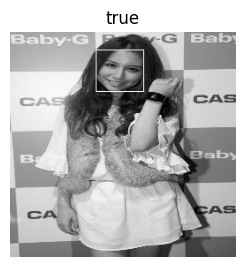

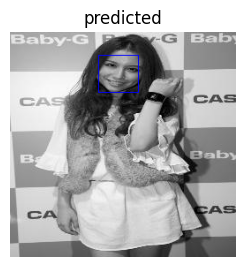

51. Image

true value of bounding box:
[134.0, 45.42797494780793, 30.75, 34.56089074460682]

predicted value of bounding box:
[138.09310913085938, 66.09992218017578, 13.797772407531738, 17.055770874023438]


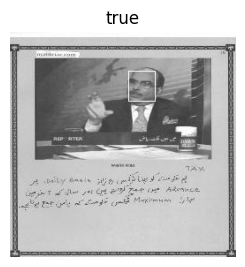

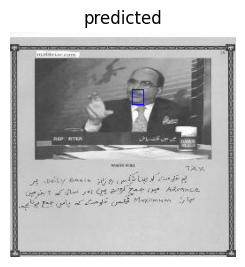

52. Image

true value of bounding box:
[102.5, 37.10144927536232, 58.5, 70.92924126172208]

predicted value of bounding box:
[101.31649780273438, 31.872161865234375, 56.407928466796875, 62.30026626586914]


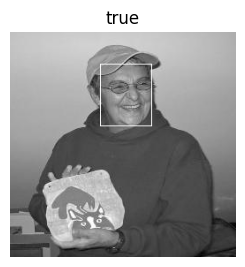

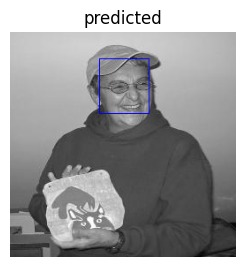

53. Image

true value of bounding box:
[84.75, 78.4422641509434, 53.75, 67.42943396226416]

predicted value of bounding box:
[79.50279235839844, 73.80999755859375, 55.865379333496094, 85.29033660888672]


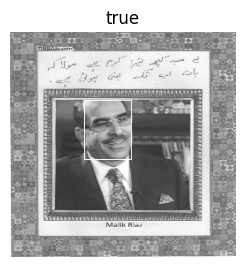

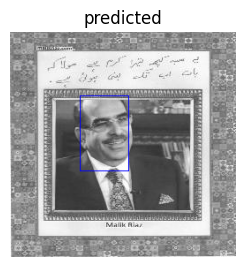

54. Image

true value of bounding box:
[28.0, 60.95238095238095, 132.75, 147.03589743589743]

predicted value of bounding box:
[86.77346801757812, 132.82286071777344, 58.496341705322266, 76.52128601074219]


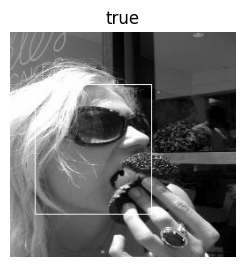

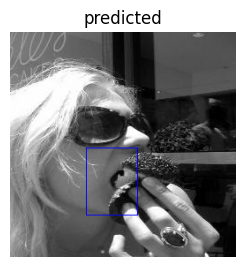

55. Image

true value of bounding box:
[121.5, 39.98641765704584, 42.0, 102.57385398981324]

predicted value of bounding box:
[110.03382110595703, 31.777788162231445, 48.973976135253906, 106.42672729492188]


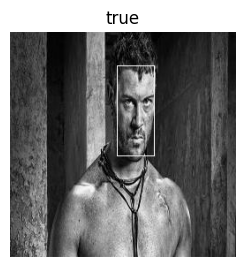

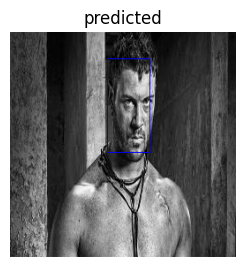

56. Image

true value of bounding box:
[107.0, 42.666666666666664, 30.5, 80.0]

predicted value of bounding box:
[104.25032806396484, 39.77436447143555, 33.07558059692383, 76.76192474365234]


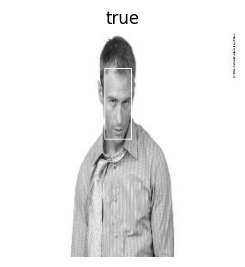

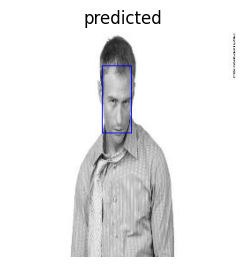

57. Image

true value of bounding box:
[232.5, 94.0, 15.0, 28.0]

predicted value of bounding box:
[145.84413146972656, 93.83648681640625, 10.450648307800293, 19.144792556762695]


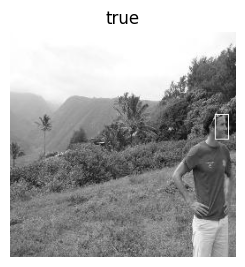

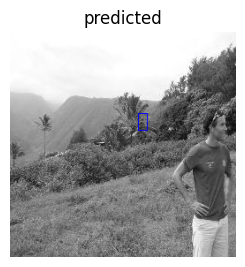

58. Image

true value of bounding box:
[86.25, 22.548344370860928, 50.25, 45.60529801324503]

predicted value of bounding box:
[90.49808502197266, 24.780372619628906, 46.20294952392578, 39.475955963134766]


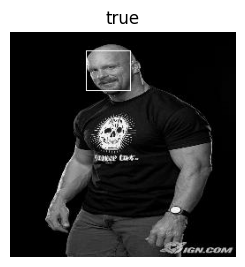

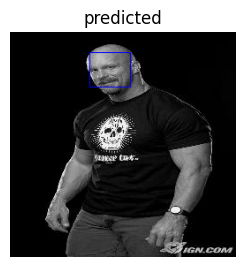

59. Image

true value of bounding box:
[64.0, 79.11111111111111, 13.5, 36.44444444444444]

predicted value of bounding box:
[100.30304718017578, 99.2451400756836, 18.26395606994629, 35.39159393310547]


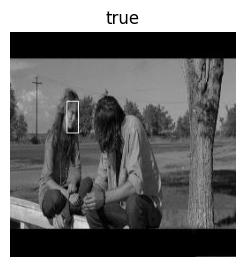

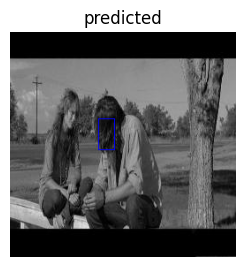

60. Image

true value of bounding box:
[181.0, 33.78299120234604, 20.0, 46.54545454545455]

predicted value of bounding box:
[199.39895629882812, 28.367279052734375, 16.21477699279785, 36.09588623046875]


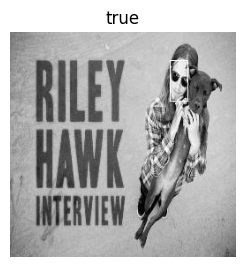

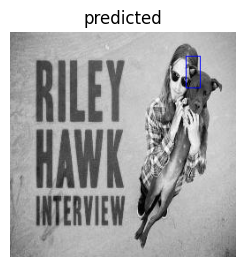

61. Image

true value of bounding box:
[116.0, 64.66666666666667, 29.0, 48.666666666666664]

predicted value of bounding box:
[116.99512481689453, 66.10284423828125, 22.391956329345703, 43.85053253173828]


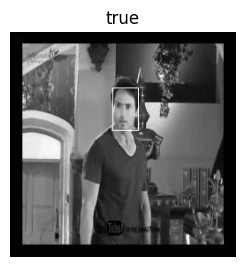

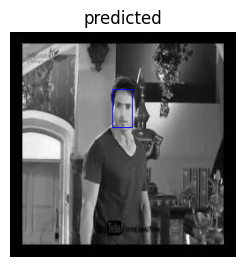

62. Image

true value of bounding box:
[70.75, 72.33078101071976, 84.75, 91.93261868300154]

predicted value of bounding box:
[133.66897583007812, 61.78060531616211, 76.31246948242188, 94.13150787353516]


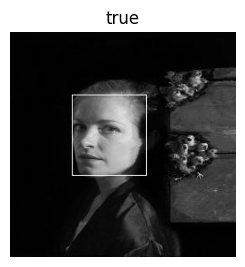

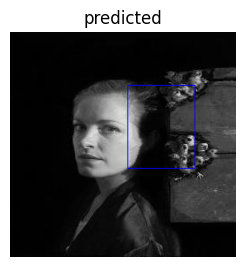

63. Image

true value of bounding box:
[97.5, 66.33769813921434, 89.75, 79.92281185389386]

predicted value of bounding box:
[117.80095672607422, 73.27777862548828, 59.1121940612793, 65.93120574951172]


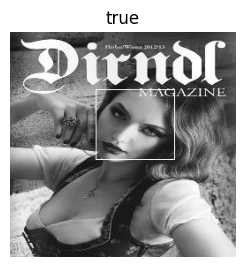

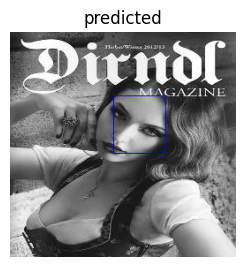

64. Image

true value of bounding box:
[94.5, 34.74285714285714, 57.0, 110.32380952380953]

predicted value of bounding box:
[100.66859436035156, 56.088504791259766, 51.22389221191406, 88.31913757324219]


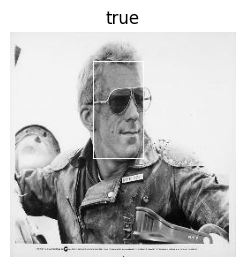

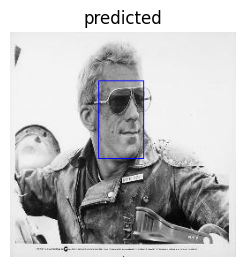

65. Image

true value of bounding box:
[130.0, 71.21522693997072, 18.0, 38.23133235724744]

predicted value of bounding box:
[125.91478729248047, 72.5169677734375, 16.82655143737793, 32.590858459472656]


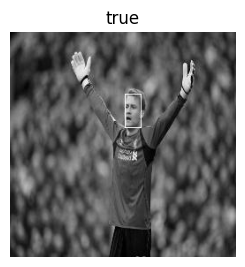

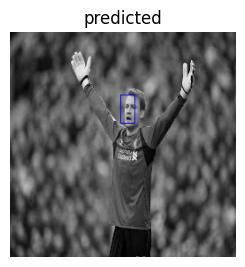

66. Image

true value of bounding box:
[85.5, 44.44444444444444, 51.0, 122.66666666666667]

predicted value of bounding box:
[90.39395141601562, 47.42972183227539, 37.249298095703125, 103.3411865234375]


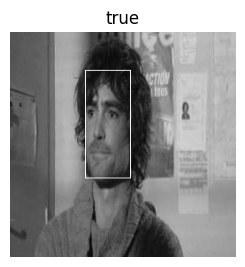

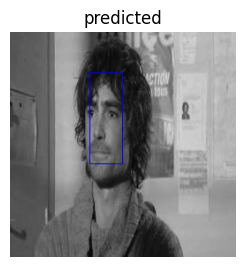

67. Image

true value of bounding box:
[52.25, 49.9290780141844, 87.0, 123.00709219858156]

predicted value of bounding box:
[50.56681442260742, 49.25031280517578, 83.55792999267578, 122.3294448852539]


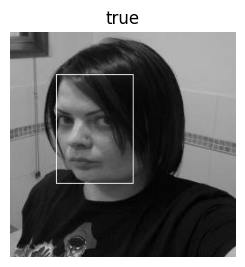

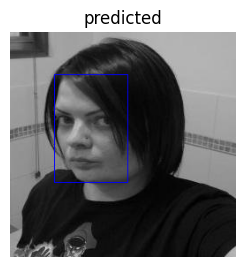

68. Image

true value of bounding box:
[122.0, 24.925329428989752, 47.25, 51.912152269399705]

predicted value of bounding box:
[124.02291107177734, 22.902917861938477, 47.23283386230469, 48.83130645751953]


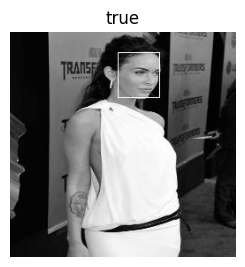

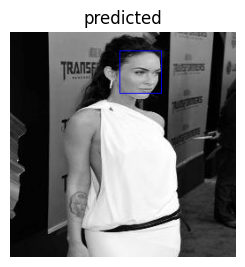

69. Image

true value of bounding box:
[76.0, 7.552795031055901, 96.25, 120.04968944099379]

predicted value of bounding box:
[75.6309585571289, 44.05296325683594, 87.71247863769531, 85.44720458984375]


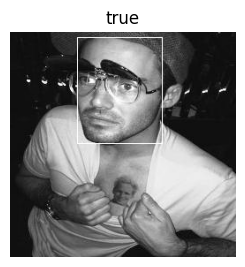

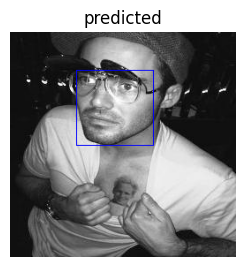

70. Image

true value of bounding box:
[99.5, 14.5, 65.5, 107.5]

predicted value of bounding box:
[97.71705627441406, 19.383678436279297, 63.666805267333984, 104.20758819580078]


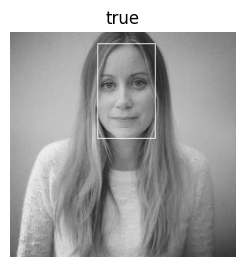

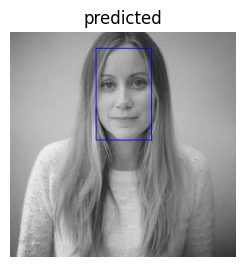

71. Image

true value of bounding box:
[102.0, 13.578783151326054, 53.0, 122.20904836193448]

predicted value of bounding box:
[117.13078308105469, 62.256160736083984, 31.46098518371582, 70.46298217773438]


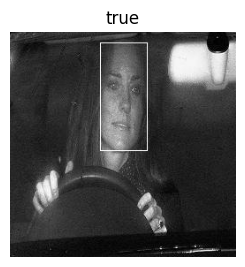

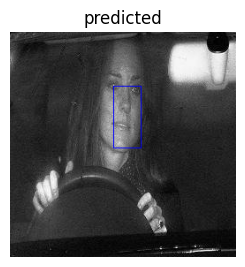

72. Image

true value of bounding box:
[97.5, 54.08450704225352, 46.0, 73.31455399061034]

predicted value of bounding box:
[95.88748168945312, 59.8187141418457, 34.22859573364258, 62.92926025390625]


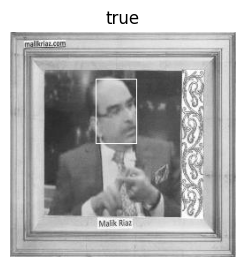

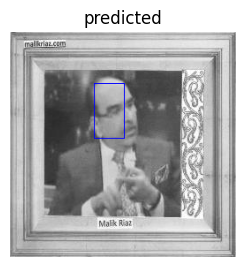

73. Image

true value of bounding box:
[60.25, 51.424397370343314, 124.25, 135.01241782322865]

predicted value of bounding box:
[59.194847106933594, 33.320316314697266, 138.159423828125, 153.89578247070312]


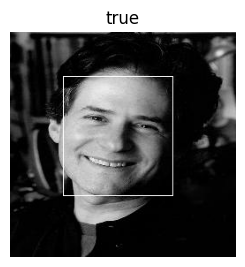

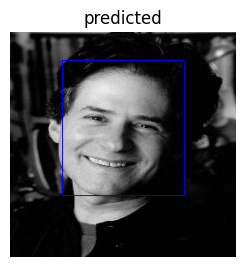

74. Image

true value of bounding box:
[104.5, 44.41640378548896, 42.5, 107.40694006309148]

predicted value of bounding box:
[102.25535583496094, 41.23888397216797, 41.753746032714844, 116.46417999267578]


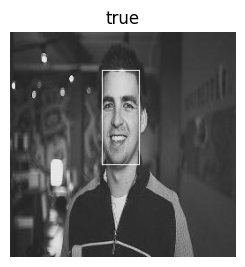

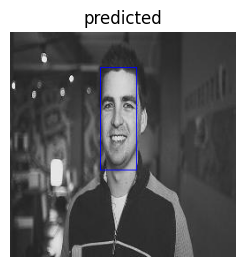

75. Image

true value of bounding box:
[157.5, 9.745241581259151, 31.5, 56.22254758418741]

predicted value of bounding box:
[168.5449981689453, 21.964046478271484, 24.364648818969727, 37.93924331665039]


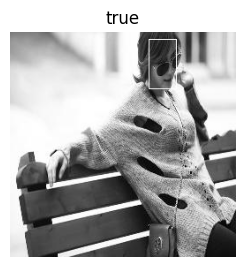

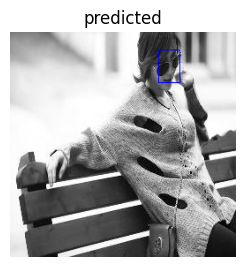

76. Image

true value of bounding box:
[164.0, 46.319870759289174, 17.5, 42.18416801292407]

predicted value of bounding box:
[166.45394897460938, 44.015384674072266, 11.22907543182373, 36.22563171386719]


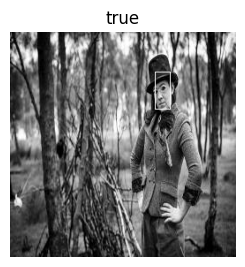

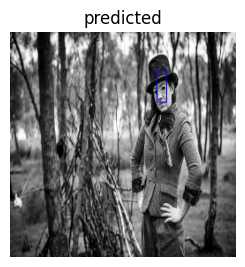

77. Image

true value of bounding box:
[71.0, 21.333333333333332, 46.5, 92.44444444444444]

predicted value of bounding box:
[76.8939437866211, 30.565326690673828, 34.498897552490234, 71.91493225097656]


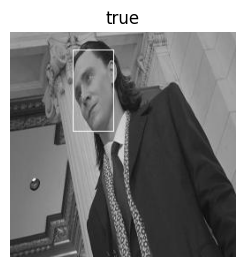

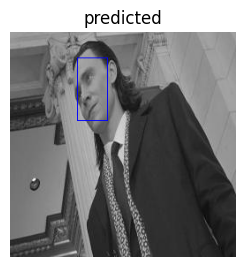

78. Image

true value of bounding box:
[104.75, 124.43923865300147, 110.75, 108.5095168374817]

predicted value of bounding box:
[66.83628845214844, 86.1575927734375, 102.8608627319336, 100.98224639892578]


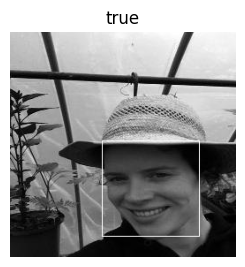

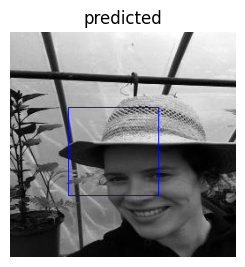

79. Image

true value of bounding box:
[41.0, 56.38766519823788, 14.5, 42.10279001468429]

predicted value of bounding box:
[128.69528198242188, 69.48475646972656, 44.796382904052734, 72.54884338378906]


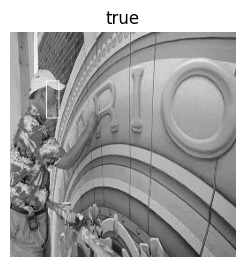

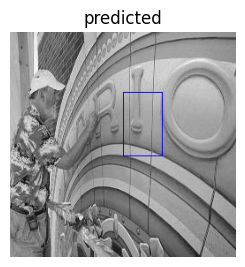

80. Image

true value of bounding box:
[114.5, 20.32941176470588, 29.5, 62.49411764705882]

predicted value of bounding box:
[116.7080078125, 20.843324661254883, 28.203018188476562, 60.991188049316406]


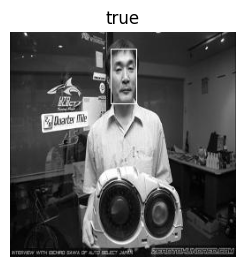

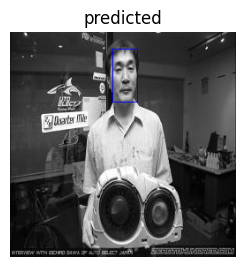

81. Image

true value of bounding box:
[114.5, 56.421052631578945, 34.5, 86.73684210526316]

predicted value of bounding box:
[107.51483154296875, 52.23189926147461, 35.508487701416016, 86.75425720214844]


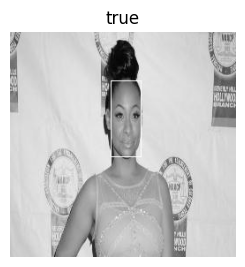

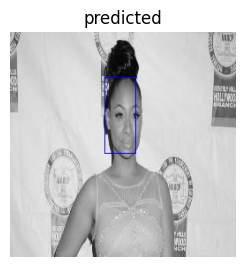

82. Image

true value of bounding box:
[87.5, 47.12636505460218, 36.5, 69.49141965678628]

predicted value of bounding box:
[109.4161148071289, 80.12802124023438, 12.290419578552246, 26.663488388061523]


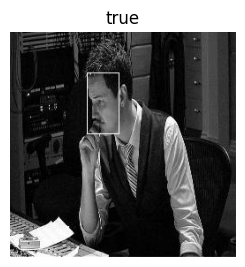

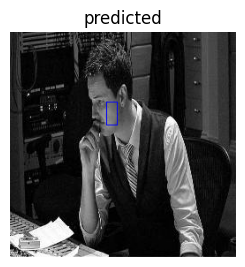

83. Image

true value of bounding box:
[99.0, 0.0, 49.5, 103.11111111111111]

predicted value of bounding box:
[101.4258804321289, 2.9280502796173096, 51.19658279418945, 122.92308044433594]


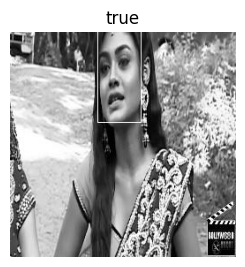

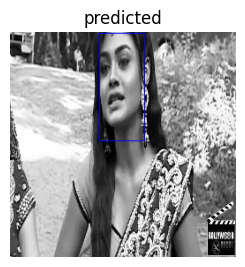

84. Image

true value of bounding box:
[45.5, 13.333333333333334, 80.0, 214.22222222222223]

predicted value of bounding box:
[41.902103424072266, 23.00284194946289, 82.35908508300781, 186.9713897705078]


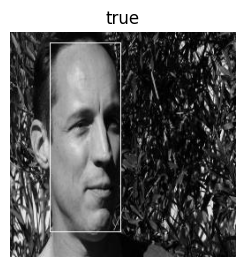

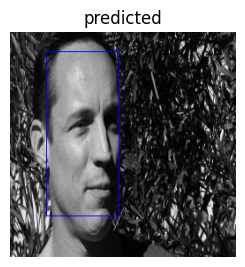

85. Image

true value of bounding box:
[62.25, 20.427843803056028, 85.75, 116.48217317487267]

predicted value of bounding box:
[59.975311279296875, 11.072030067443848, 99.5609359741211, 121.26959228515625]


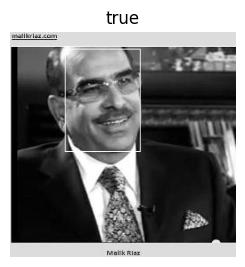

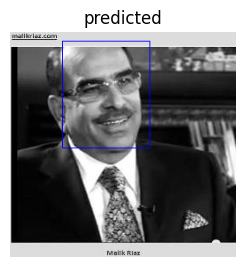

86. Image

true value of bounding box:
[94.0, 43.55555555555556, 33.0, 80.0]

predicted value of bounding box:
[92.42263793945312, 52.98037338256836, 31.63368797302246, 85.921630859375]


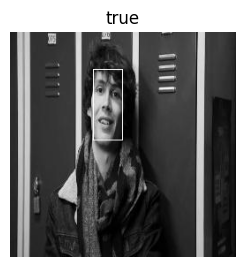

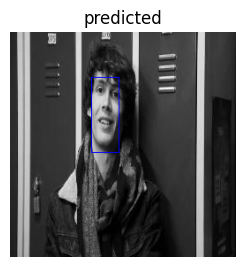

87. Image

true value of bounding box:
[85.75, 42.87439143135346, 88.75, 119.89873417721519]

predicted value of bounding box:
[84.15460968017578, 41.64760971069336, 91.21281433105469, 124.6584243774414]


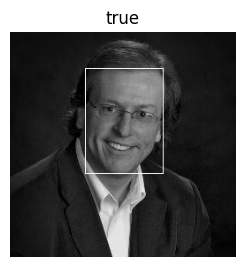

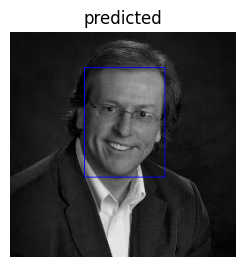

88. Image

true value of bounding box:
[195.5, 104.7953216374269, 17.5, 33.68421052631579]

predicted value of bounding box:
[105.93594360351562, 40.365142822265625, 24.67683219909668, 27.602081298828125]


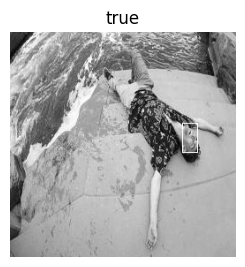

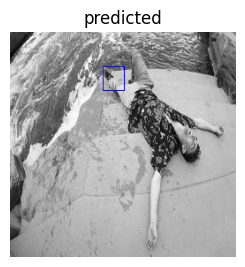

89. Image

true value of bounding box:
[108.0, 37.333333333333336, 32.0, 84.44444444444444]

predicted value of bounding box:
[108.40267181396484, 40.263938903808594, 27.712953567504883, 71.2767562866211]


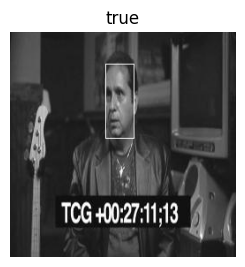

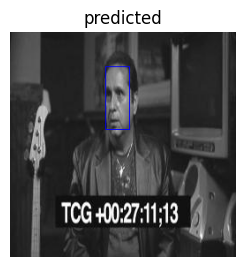

90. Image

true value of bounding box:
[141.25, 68.60686600221484, 21.25, 18.569213732004428]

predicted value of bounding box:
[150.54063415527344, 73.23966217041016, 19.281152725219727, 15.193388938903809]


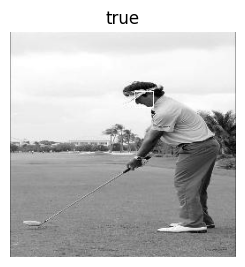

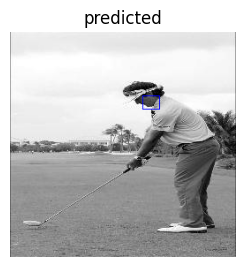

91. Image

true value of bounding box:
[70.0, 19.54464894342195, 76.5, 72.41990456714383]

predicted value of bounding box:
[74.83492279052734, 14.017660140991211, 68.0572738647461, 74.07557678222656]


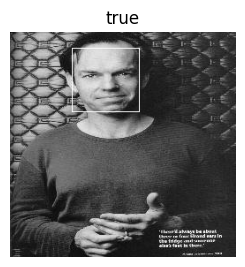

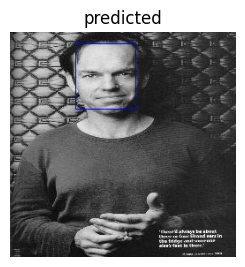

92. Image

true value of bounding box:
[166.0, 21.705735660847882, 34.5, 125.12718204488777]

predicted value of bounding box:
[171.0933074951172, 48.07657241821289, 18.296295166015625, 48.745914459228516]


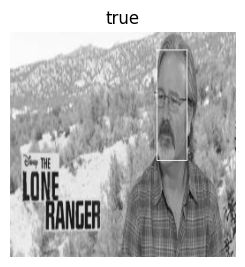

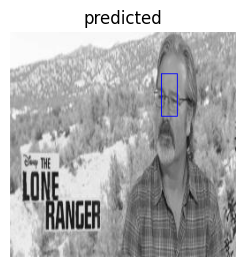

93. Image

true value of bounding box:
[102.75, 16.489264801561482, 25.5, 25.483409238776837]

predicted value of bounding box:
[100.01097106933594, 52.69273376464844, 20.119585037231445, 23.844369888305664]


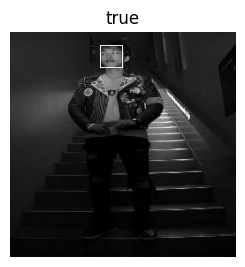

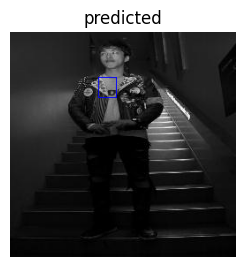

94. Image

true value of bounding box:
[170.0, 46.35390946502058, 33.5, 110.61728395061728]

predicted value of bounding box:
[166.85986328125, 54.4223518371582, 34.12165069580078, 67.85860443115234]


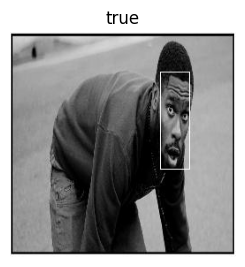

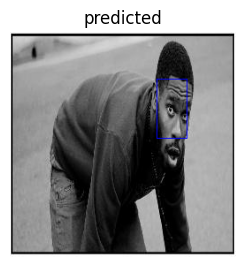

95. Image

true value of bounding box:
[0.75, 23.458909090909092, 175.25, 153.6]

predicted value of bounding box:
[17.855255126953125, 31.122854232788086, 144.46200561523438, 138.6378173828125]


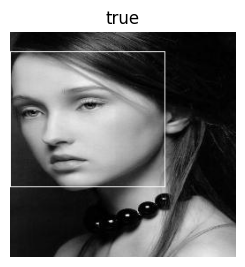

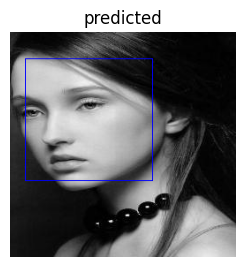

96. Image

true value of bounding box:
[80.0, 44.0, 73.0, 144.0]

predicted value of bounding box:
[96.1209945678711, 42.80794143676758, 59.379295349121094, 158.95932006835938]


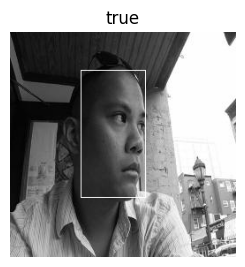

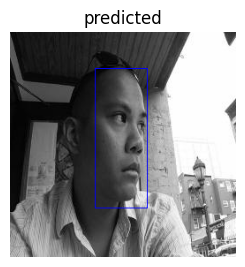

97. Image

true value of bounding box:
[73.0, 54.5, 88.5, 104.5]

predicted value of bounding box:
[71.0232162475586, 47.21284484863281, 85.96192169189453, 137.1578369140625]


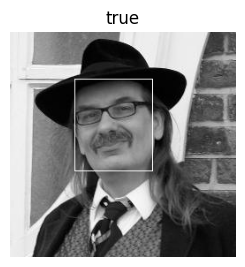

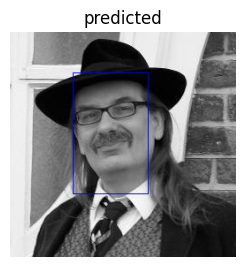

98. Image

true value of bounding box:
[128.5, 139.14714714714714, 19.0, 33.825825825825824]

predicted value of bounding box:
[127.894287109375, 113.57315826416016, 17.841495513916016, 29.447023391723633]


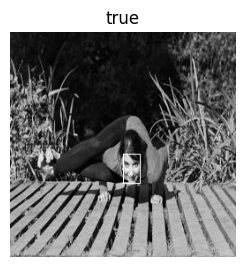

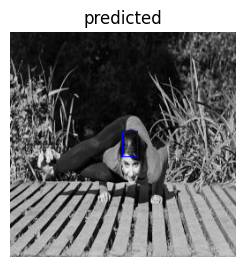

99. Image

true value of bounding box:
[138.0, 38.50406504065041, 45.0, 124.8780487804878]

predicted value of bounding box:
[138.64080810546875, 40.10057067871094, 40.4205207824707, 120.04613494873047]


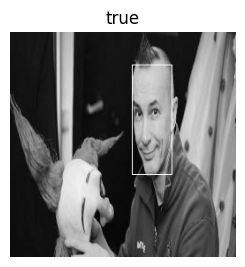

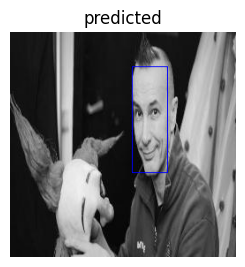

In [37]:
#test for images in test dataset
pics = range(50,100)
model.load_state_dict(torch.load('./model_google-gray-60-epoch-1-chn.pth'))
model.eval()

for i in pics:
    print(str(i) + ". Image")
    print()
    test_image(i)

In [38]:
model.load_state_dict(torch.load('./model_google-gray-60-epoch-1-chn.pth'))
criterion2 = nn.L1Loss(size_average=False, reduce=False, reduction='none')
test_loss_google = evaluate(model, test_loader, criterion2, test_size, device, 15)

In [39]:
#print("avg test acc for starting model: " + str(test_loss_starting) + "%")
#print("avg test acc for mlohave sise model: " + str(test_loss_mlohave) + "%")
#print("avg test acc for AlexNet model: " + str(test_loss_alex) + "%")
print("avg test acc for GoogLeNet model: " + str(test_loss_google) + "%")

avg test acc for GoogLeNet model: 83.97321428571429%
